In [1]:
%env CONDA_PREFIX

'C:\\Users\\ai41\\anaconda3\\envs\\tensorflow'

In [82]:
from tensorflow import keras
import tensorflow as tf
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns; sns.set()
import os

In [83]:
import cv2   #opencv
import imutils

In [84]:
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.layers import Dense, Dropout, Flatten, Conv2D, MaxPooling2D

In [78]:
#IMG_DIR="d:/Ai/project1/imgs/train"
IMG_DIR="d:/Ai/project1/"
df_test = pd.read_csv(IMG_DIR+"sample_submission.csv")
df_test["ans"] = range(0,len(df_test))
y_test=df_test["ans"]
df_test.head(20)

,img,c0,c1,c2,c3,c4,c5,c6,c7,c8,c9,ans
0,img_1.jpg,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0
1,img_10.jpg,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,1
2,img_100.jpg,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,2
3,img_1000.jpg,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,3
4,img_100000.jpg,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,4
5,img_100001.jpg,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,5
6,img_100002.jpg,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,6
7,img_100003.jpg,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,7
8,img_100004.jpg,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,8
9,img_100005.jpg,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,9


In [74]:
df_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 79726 entries, 0 to 79725
Data columns (total 11 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   img     79726 non-null  object 
 1   c0      79726 non-null  float64
 2   c1      79726 non-null  float64
 3   c2      79726 non-null  float64
 4   c3      79726 non-null  float64
 5   c4      79726 non-null  float64
 6   c5      79726 non-null  float64
 7   c6      79726 non-null  float64
 8   c7      79726 non-null  float64
 9   c8      79726 non-null  float64
 10  c9      79726 non-null  float64
dtypes: float64(10), object(1)
memory usage: 6.7+ MB


In [6]:
y_img = df_test["img"]

In [7]:
#IMG_DIR="d:/Ai/project1/imgs/train"
IMG_DIR="d:/Ai/project1/"
df_train = pd.read_csv(IMG_DIR+"driver_imgs_list.csv")

x = df_train["classname"]
y = df_train["img"]

print(type(df_train))
print(type(x))
df_train.head(20)

<class 'pandas.core.frame.DataFrame'>
<class 'pandas.core.series.Series'>


,subject,classname,img
0,p002,c0,img_44733.jpg
1,p002,c0,img_72999.jpg
2,p002,c0,img_25094.jpg
3,p002,c0,img_69092.jpg
4,p002,c0,img_92629.jpg
5,p002,c0,img_3370.jpg
6,p002,c0,img_67639.jpg
7,p002,c0,img_58560.jpg
8,p002,c0,img_35779.jpg
9,p002,c0,img_10012.jpg


In [8]:
x.shape, y.shape

((22424,), (22424,))

<AxesSubplot:>

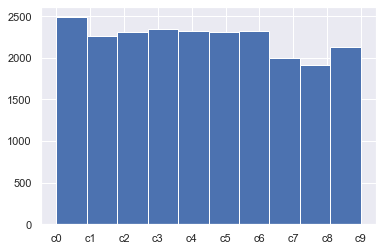

In [9]:
x.hist()

In [10]:
x.unique()

array(['c0', 'c1', 'c2', 'c3', 'c4', 'c5', 'c6', 'c7', 'c8', 'c9'],
      dtype=object)

idx= 65817 , row['img']= img_83968.jpg
d:/Ai/project1/imgs/test/img_83968.jpg
idx= 64139 , row['img']= img_82055.jpg
d:/Ai/project1/imgs/test/img_82055.jpg
idx= 8260 , row['img']= img_17528.jpg
d:/Ai/project1/imgs/test/img_17528.jpg
idx= 25125 , row['img']= img_3706.jpg
d:/Ai/project1/imgs/test/img_3706.jpg
idx= 65644 , row['img']= img_83775.jpg
d:/Ai/project1/imgs/test/img_83775.jpg
idx= 78534 , row['img']= img_98628.jpg
d:/Ai/project1/imgs/test/img_98628.jpg
idx= 12292 , row['img']= img_22210.jpg
d:/Ai/project1/imgs/test/img_22210.jpg
idx= 50799 , row['img']= img_66631.jpg
d:/Ai/project1/imgs/test/img_66631.jpg
idx= 19540 , row['img']= img_30593.jpg
d:/Ai/project1/imgs/test/img_30593.jpg
idx= 7393 , row['img']= img_16555.jpg
d:/Ai/project1/imgs/test/img_16555.jpg
idx= 19997 , row['img']= img_31118.jpg
d:/Ai/project1/imgs/test/img_31118.jpg
idx= 62391 , row['img']= img_80050.jpg
d:/Ai/project1/imgs/test/img_80050.jpg
idx= 69555 , row['img']= img_8830.jpg
d:/Ai/project1/imgs/test/img_8

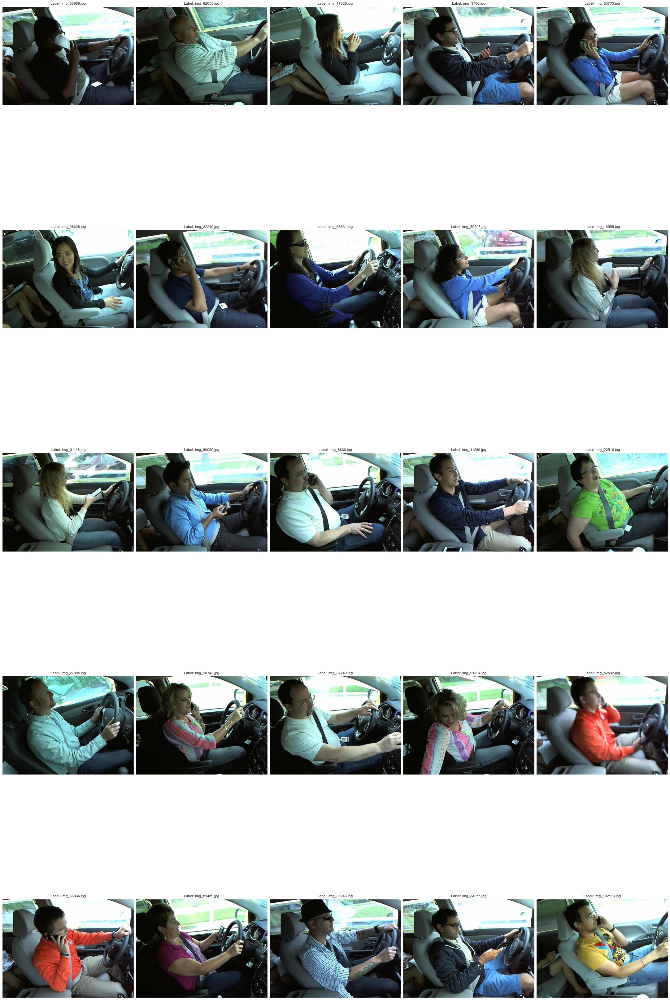

In [38]:
fig = plt.figure(figsize=(30, 50))
X_train=[]
for i, (idx, row) in enumerate(df_test.loc[df_test['img'] == y_img ].iterrows()):
    print('idx=', idx,", row['img']=", row['img'])
    path=IMG_DIR+f'imgs/test/{row["img"]}'
    print(path)
    test_image = cv2.imread(path)
    test_image = cv2.cvtColor(test_image, cv2.COLOR_BGR2RGB)   
    test_image = cv2.resize(image, (128, 96))
    X_traim.append(test_image)


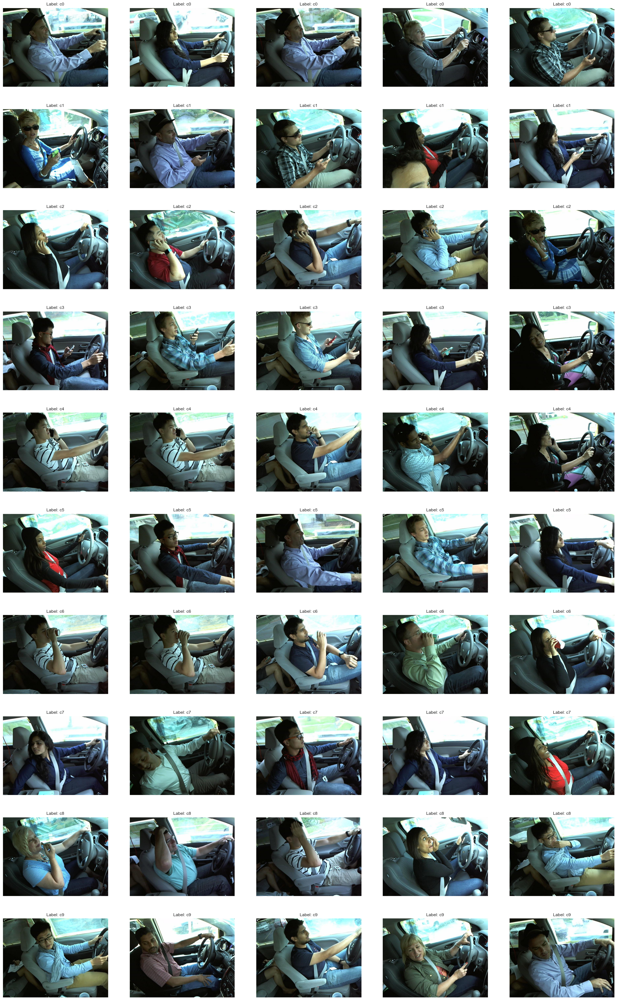

In [63]:
plt.figure(figsize=(30, 50))
n_samples = 5
# display 10 images from each class
#plt.subplots(10, n_samples)
plt.tight_layout(pad=0.4, w_pad=0.5, h_pad=1.0)
for class_id in sorted(x.unique()):
    for i, (idx, row) in enumerate(df_train.loc[df_train['classname'] == class_id].iterrows()):
        #print('class_id=', class_id,', idx=', idx,", row['img']=", row['img'])
        plt.subplot(10, n_samples, int(class_id[1])*n_samples+i+1, xticks=[], yticks=[])

        path=IMG_DIR+f'imgs/train/{row["classname"]}/{row["img"]}'
        #print(path)
        train_image = cv2.imread(path)
        train_image = cv2.cvtColor(train_image, cv2.COLOR_BGR2RGB)   
        #image = cv2.resize(image, (128, 96))


idx= 65817 , row['img']= img_83968.jpg
d:/Ai/project1/imgs/test/img_83968.jpg
idx= 64139 , row['img']= img_82055.jpg
d:/Ai/project1/imgs/test/img_82055.jpg
idx= 8260 , row['img']= img_17528.jpg
d:/Ai/project1/imgs/test/img_17528.jpg
idx= 25125 , row['img']= img_3706.jpg
d:/Ai/project1/imgs/test/img_3706.jpg
idx= 65644 , row['img']= img_83775.jpg
d:/Ai/project1/imgs/test/img_83775.jpg
idx= 78534 , row['img']= img_98628.jpg
d:/Ai/project1/imgs/test/img_98628.jpg
idx= 12292 , row['img']= img_22210.jpg
d:/Ai/project1/imgs/test/img_22210.jpg
idx= 50799 , row['img']= img_66631.jpg
d:/Ai/project1/imgs/test/img_66631.jpg
idx= 19540 , row['img']= img_30593.jpg
d:/Ai/project1/imgs/test/img_30593.jpg
idx= 7393 , row['img']= img_16555.jpg
d:/Ai/project1/imgs/test/img_16555.jpg
idx= 19997 , row['img']= img_31118.jpg
d:/Ai/project1/imgs/test/img_31118.jpg
idx= 62391 , row['img']= img_80050.jpg
d:/Ai/project1/imgs/test/img_80050.jpg
idx= 69555 , row['img']= img_8830.jpg
d:/Ai/project1/imgs/test/img_8

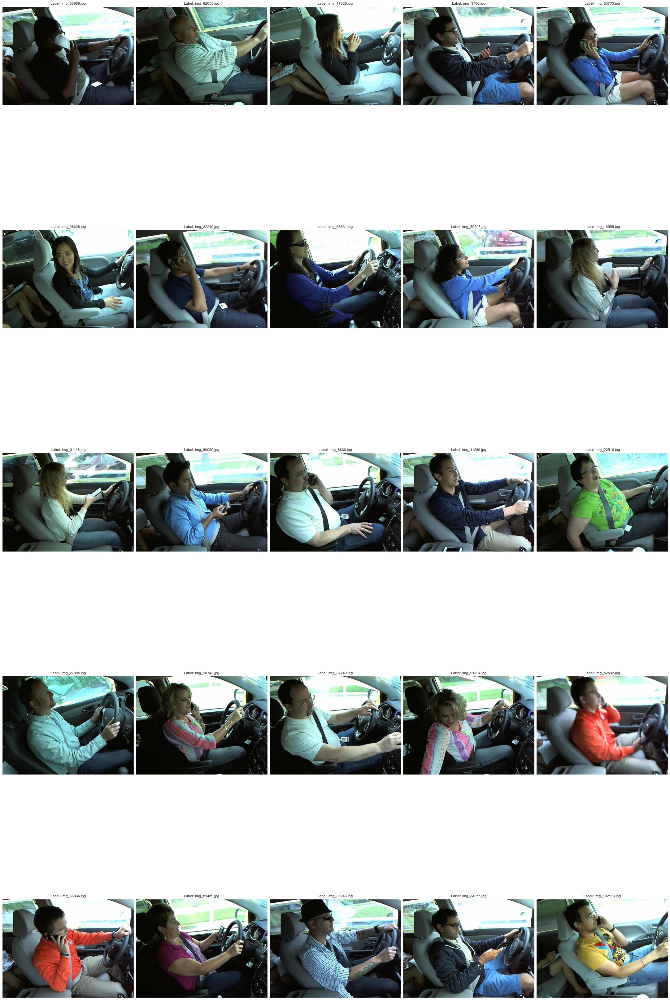

In [38]:

n_samples=5
# display 10 images from each class

for i, (idx, row) in enumerate(df_test.loc[df_test['img'] == y_img ].sample(25, random_state=77).iterrows()):
    print('idx=', idx,", row['img']=", row['img'])
    ax = fig.add_subplot(10, n_samples, (i//n_samples)*n_samples+i+1, xticks=[], yticks=[])

    path=IMG_DIR+f'imgs/test/{row["img"]}'
    print(path)
    test_image = cv2.imread(path)
    test_image = cv2.cvtColor(test_image, cv2.COLOR_BGR2RGB)   
    #image = cv2.resize(image, (128, 96))

    plt.imshow(test_image)
    ax.set_title('Label: %s' % (row['img']) )
plt.tight_layout(pad=0.4, w_pad=0.5, h_pad=1.0)
plt.show()

In [64]:
print(train_image)
print(train_image.shape)
print(train_image.shape[0])
print(train_image[0].shape)

[[[ 16  17  11]
  [ 15  16  10]
  [ 15  16  10]
  ...
  [219 255 202]
  [219 255 202]
  [220 255 203]]

 [[ 16  17  11]
  [ 15  16  10]
  [ 15  16  10]
  ...
  [217 255 198]
  [219 255 202]
  [222 255 205]]

 [[ 16  17  11]
  [ 16  17  11]
  [ 15  16  10]
  ...
  [212 250 191]
  [218 255 197]
  [222 255 201]]

 ...

 [[ 14  15  10]
  [ 14  15  10]
  [ 14  15  10]
  ...
  [ 26  35  30]
  [ 46  55  50]
  [ 47  58  52]]

 [[ 14  15  10]
  [ 14  15  10]
  [ 15  16  11]
  ...
  [ 24  33  28]
  [ 43  52  47]
  [ 43  54  48]]

 [[ 14  15  10]
  [ 14  15  10]
  [ 15  16  11]
  ...
  [ 23  32  27]
  [ 41  50  45]
  [ 41  52  46]]]
(480, 640, 3)
480
(640, 3)


In [67]:
print(test_image)
print(test_image.shape)
print(test_image.shape[0])
print(test_image[0].shape)

[[[ 30  38  23]
  [ 68  79  63]
  [ 97 110  93]
  ...
  [197 248 243]
  [213 255 255]
  [216 255 255]]

 [[179 190 174]
  [231 242 226]
  [242 255 238]
  ...
  [205 251 248]
  [221 255 255]
  [224 255 255]]

 [[239 250 234]
  [238 249 233]
  [231 244 227]
  ...
  [218 254 252]
  [227 255 255]
  [226 254 255]]

 ...

 [[ 42  61  55]
  [ 41  60  54]
  [ 44  61  55]
  ...
  [ 24  18  20]
  [ 25  19  21]
  [ 25  19  21]]

 [[ 43  62  56]
  [ 42  61  55]
  [ 46  63  57]
  ...
  [ 23  17  19]
  [ 24  18  20]
  [ 25  19  21]]

 [[ 41  60  54]
  [ 41  60  54]
  [ 45  62  56]
  ...
  [ 22  16  18]
  [ 24  18  20]
  [ 25  19  21]]]
(480, 640, 3)
480
(640, 3)


In [86]:
X_train=train_image
print(X_test)

#0~255 값을 0~1사이값으로 min_max정규화
X_train =X_train / 255.

Y_train = np.array(x)
Y_train = Y_train.reshape(-1,1)

print(X_train)
print(X_train[0].shape)
print(X_train.shape)
print(Y_train.shape)

[[[0.11764706 0.14901961 0.09019608]
  [0.26666667 0.30980392 0.24705882]
  [0.38039216 0.43137255 0.36470588]
  ...
  [0.77254902 0.97254902 0.95294118]
  [0.83529412 1.         1.        ]
  [0.84705882 1.         1.        ]]

 [[0.70196078 0.74509804 0.68235294]
  [0.90588235 0.94901961 0.88627451]
  [0.94901961 1.         0.93333333]
  ...
  [0.80392157 0.98431373 0.97254902]
  [0.86666667 1.         1.        ]
  [0.87843137 1.         1.        ]]

 [[0.9372549  0.98039216 0.91764706]
  [0.93333333 0.97647059 0.91372549]
  [0.90588235 0.95686275 0.89019608]
  ...
  [0.85490196 0.99607843 0.98823529]
  [0.89019608 1.         1.        ]
  [0.88627451 0.99607843 1.        ]]

 ...

 [[0.16470588 0.23921569 0.21568627]
  [0.16078431 0.23529412 0.21176471]
  [0.17254902 0.23921569 0.21568627]
  ...
  [0.09411765 0.07058824 0.07843137]
  [0.09803922 0.0745098  0.08235294]
  [0.09803922 0.0745098  0.08235294]]

 [[0.16862745 0.24313725 0.21960784]
  [0.16470588 0.23921569 0.21568627]


In [79]:
X_test=test_image
print(X_test)

#0~255 값을 0~1사이값으로 min_max정규화
X_test =X_test / 255.

Y_test = np.array(y_test)
Y_test = Y_test.reshape(-1,1)

print(X_test)
print(X_test[0].shape)
print(X_test.shape)
print(Y_test.shape)

[[[ 30  38  23]
  [ 68  79  63]
  [ 97 110  93]
  ...
  [197 248 243]
  [213 255 255]
  [216 255 255]]

 [[179 190 174]
  [231 242 226]
  [242 255 238]
  ...
  [205 251 248]
  [221 255 255]
  [224 255 255]]

 [[239 250 234]
  [238 249 233]
  [231 244 227]
  ...
  [218 254 252]
  [227 255 255]
  [226 254 255]]

 ...

 [[ 42  61  55]
  [ 41  60  54]
  [ 44  61  55]
  ...
  [ 24  18  20]
  [ 25  19  21]
  [ 25  19  21]]

 [[ 43  62  56]
  [ 42  61  55]
  [ 46  63  57]
  ...
  [ 23  17  19]
  [ 24  18  20]
  [ 25  19  21]]

 [[ 41  60  54]
  [ 41  60  54]
  [ 45  62  56]
  ...
  [ 22  16  18]
  [ 24  18  20]
  [ 25  19  21]]]
[[[0.11764706 0.14901961 0.09019608]
  [0.26666667 0.30980392 0.24705882]
  [0.38039216 0.43137255 0.36470588]
  ...
  [0.77254902 0.97254902 0.95294118]
  [0.83529412 1.         1.        ]
  [0.84705882 1.         1.        ]]

 [[0.70196078 0.74509804 0.68235294]
  [0.90588235 0.94901961 0.88627451]
  [0.94901961 1.         0.93333333]
  ...
  [0.80392157 0.9843137

In [87]:
seed=0
np.random.seed(seed)
tf.compat.v1.set_random_seed(seed)

model = Sequential()
#conv1
model.add(Conv2D(32, (5, 5), 5, input_shape=(480,640,3),      
                activation="relu"))
#maxpooling 1
model.add(MaxPooling2D(pool_size=(2,2)))
#conv2
model.add(Conv2D(64, (3,3), activation="relu"))
#maxp 2
model.add(MaxPooling2D(pool_size=(2,2)))  #conv1>mp1>conv2>mp2>flatten해서>fc1>fc2
model.add(Dropout(0.25))   
#탈락율이 25% : 다 하면 너무 학습 패턴에 맞추어진다. (과적합방지)
#어떤 뉴런은 탈락시킨다 = 이 뉴런은 수정안하고 나머지 75%는 수정, 선택되는 뉴런은 할때마다 달라진다

model.add(Conv2D(128,(3,3), activation="relu"))
model.add(MaxPooling2D(pool_size=(2,2)))
model.add(Dropout(0.5))   

model.add(Flatten())
model.add(Dense(units=30, activation="relu")) #은닉층 1 :relu,입력 17개, 뉴런 30개 
model.add(Dense(units=15, activation="relu"))
model.add(Dense(units=10, activation="softmax"))

model.compile(loss="categorical_crossentropy",  #spares는 one-hot coding 안할때
             optimizer="adam",
             metrics=["accuracy"])
#모델 저장 폴더 설정
MODEL_DIR = IMG_DIR+"CNN_project1"
if not os.path.exists (MODEL_DIR):
    os.mkdir(MODEL_DIR)                          #().mkdir :폴더 생성

#모델 저장 조건 설정            #파일이름에는 빈칸이 들어가면 안된다
modelfile = MODEL_DIR+'CNN_project1_best.h5'   
checkpointer = ModelCheckpoint(filepath=modelfile,      
                              moniter="val_loss", verbose=1,
                              save_best_only=True) 

#학습의 자동 중단 설정
early_stopping_callback = EarlyStopping(monitor="val_loss", patience=10)


#모델 학습 및 저장  
fit_history = model.fit(X_train, Y_train, 
                        epochs=50, batch_size=200, verbose=0, 
                        validation_data=(X_test,Y_test),
                        callbacks=[early_stopping_callback, checkpointer])

ValueError: Data cardinality is ambiguous:
  x sizes: 480
  y sizes: 22424
Please provide data which shares the same first dimension.

In [ ]:
print(model.summary())